In [1]:
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings
import matplotlib.pyplot as plt
import seaborn as sns
import scipy

/home/rhythm/anaconda3/lib/python3.7/site-packages/pandas/compat/_optional.py:138: UserWarning: Pandas requires version '2.7.0' or newer of 'numexpr' (version '2.6.9' currently installed).
  warnings.warn(msg, UserWarning)


In [2]:
df_1 = pd.read_csv('EvsT-2FoilBOTHEND.txt', sep = " ", header = None, names = ["Evt_id", "KE", "E1","E2","t1","t2","EDepTot"])

df_2 = pd.read_csv('EvsT-0Foil.txt', sep = " ", header = None, names = ["Evt_id", "KE", "E1","E2","t1","t2","EDepTot"])
#df_1 = pd.read_csv('EvsT.txt', sep = " ", header = None, names = ["Evt_id", "KE", "E1","E2","t1","t2","EDepTot"])
#df_3 = pd.read_csv('EvsT-2Foil.txt', sep = " ", header = None, names = ["Evt_id", "KE", "E1","E2","t1","t2","EDepTot"])
df_3 = pd.read_csv('EvsT-4FoilBOTHEND.txt', sep = " ", header = None, names = ["Evt_id", "KE", "E1","E2","t1","t2","EDepTot"])

eTOF< 150 ns and more than 20 ns

In [3]:
def extractingETOF(df):
    df['etof'] = abs(df['t1'] - df['t2'])
    df = df[df['etof'] < 150e-09]
    df = df[df['etof']  > 0.2e-7]
    return df


Defining dataframes with no foil
just one foil and then two foils

In [4]:
Foil1 = extractingETOF(df_1)
Foil0 = extractingETOF(df_2)
Foil2 = extractingETOF(df_3)

In [5]:
#looking for single energy peak at 360 keV
def discreteEnergydfs(df):
    df_360keV = df[df['KE'] < 370]
    df_380keV = df[df['KE'] > 370]
    return df_360keV, df_380keV

In [6]:
Foil0_360, Foil0_380   = discreteEnergydfs(Foil0)
Foil1_360, Foil1_380  = discreteEnergydfs(Foil1)
Foil2_360, Foil2_380  = discreteEnergydfs(Foil2)


In [9]:
def choosingDetectorHitFirst(df) :
    firstDet1 = df[df['t1']<df['t2']]
    firstDet2 = df[df['t2']<df['t1']]
    return firstDet1, firstDet2

In [10]:

firstDet1Foil0_360, firstDet2Foil0_360 = choosingDetectorHitFirst(Foil0_360)
firstDet1Foil1_360, firstDet2Foil1_360 = choosingDetectorHitFirst(Foil1_360)
firstDet1Foil2_360, firstDet2Foil2_360 = choosingDetectorHitFirst(Foil2_360)

time of flight should be defined as time it takes to hit detector 1 + time to hit detector 2

In [11]:
def plotETOF(df, title):    
    plt.figure(figsize=(14,10))
    sns.set(style = "ticks")
    sns.histplot(df.etof, binwidth = 0.5e-09, bins = 400,  color = 'orange',log_scale=(False,True), element="step", fill = True)
    plt.grid()
    plt.ylim(0, 10000)
    #plt.xlim(0.0, 200e-9)
    plt.xlabel("eTOF (sec)", fontsize = 16)
    plt.ylabel("Counts ", fontsize = 16)
    plt.xticks(fontsize = 14)
    plt.yticks(fontsize = 14)
    plt.title(title, fontsize = 18)
    return plt.show()
#plt.savefig("timingDistribution-Filled-2Foils.png")


/home/rhythm/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:1479: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ret = ax.set_ylim(*args, **kwargs)


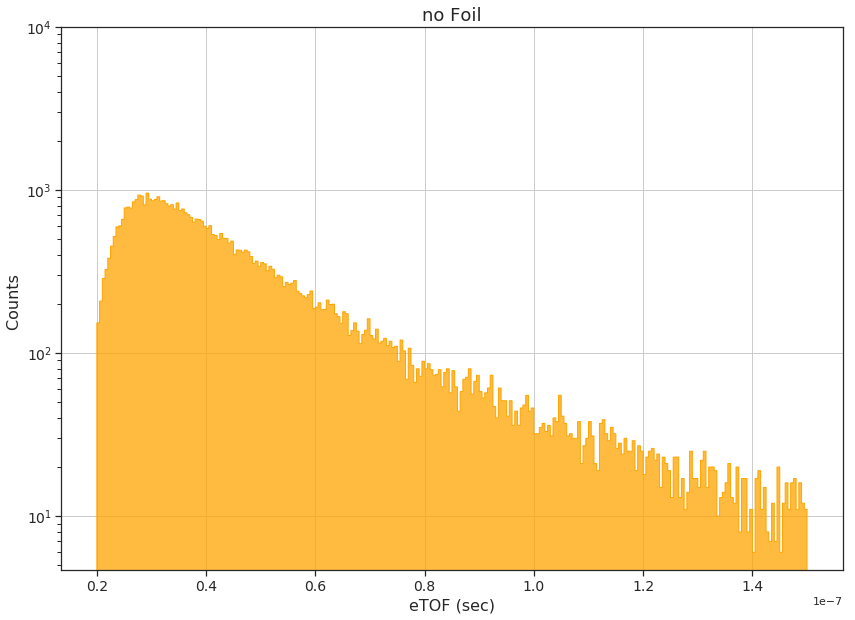

In [11]:
plotETOF(Foil0_360, title = "no Foil")

/home/rhythm/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:1479: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ret = ax.set_ylim(*args, **kwargs)


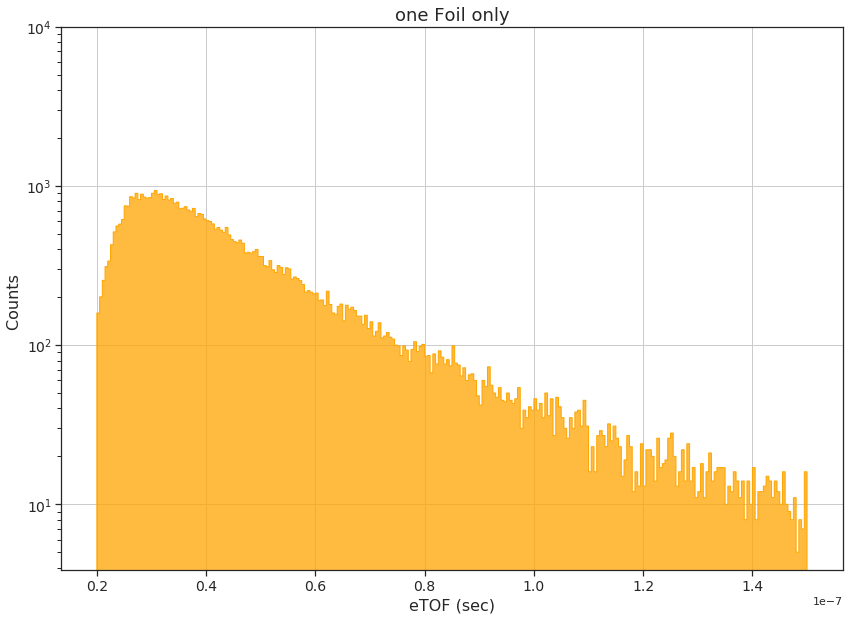

In [12]:
plotETOF(Foil1_360, title = "one Foil only")

/home/rhythm/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:1479: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ret = ax.set_ylim(*args, **kwargs)


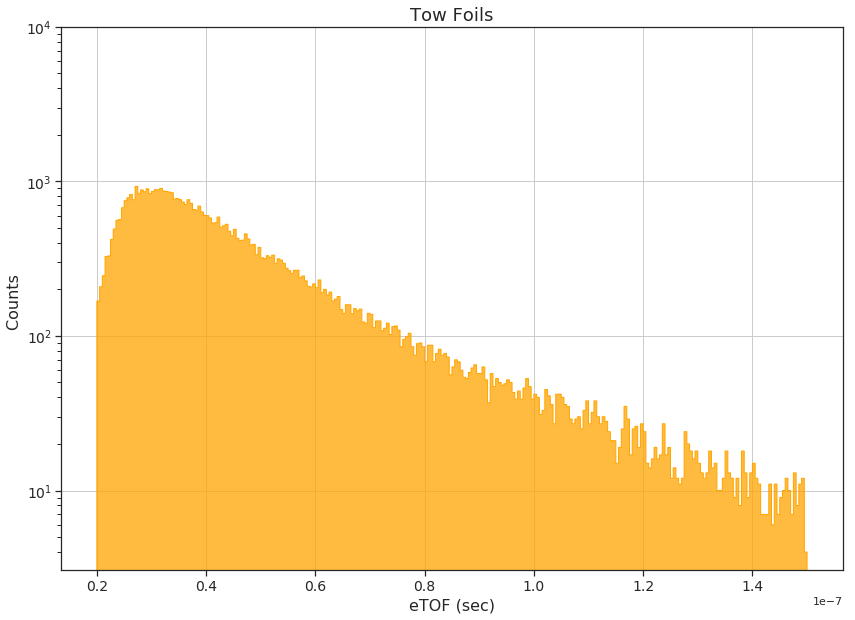

In [12]:
plotETOF(Foil2_360, title = "Tow Foils")

/home/rhythm/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:1479: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ret = ax.set_ylim(*args, **kwargs)


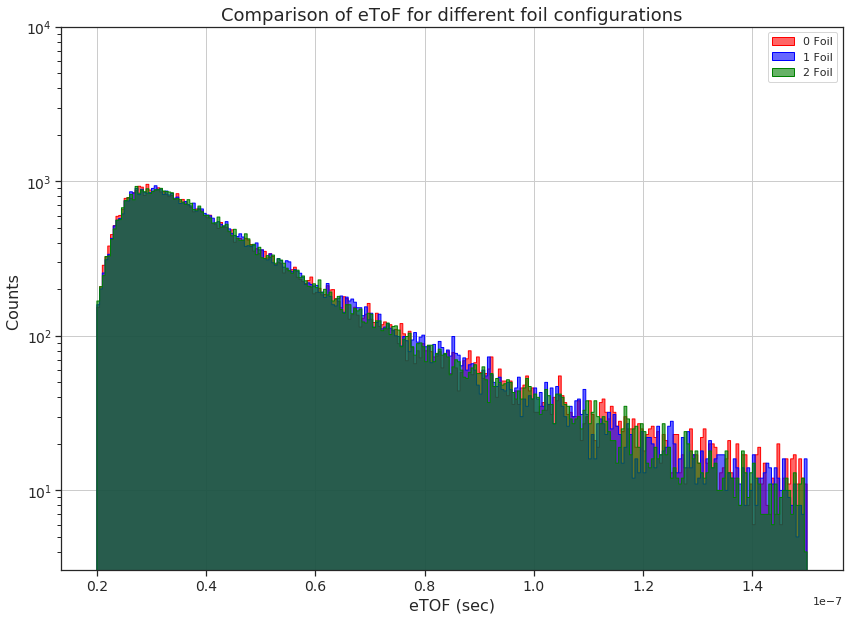

In [15]:
plt.figure(figsize=(14,10))
sns.set(style = "ticks")
sns.histplot(Foil0_360.etof, binwidth = 0.5e-09, bins = 400,  label = "0 Foil",color = 'red',log_scale=(False,True), element="step", alpha = 0.6,fill = True)
sns.histplot(Foil1_360.etof, binwidth = 0.5e-09, bins = 400,  label = "1 Foil",color = 'blue',log_scale=(False,True), element="step", alpha = 0.6,fill = True)
sns.histplot(Foil2_360.etof, binwidth = 0.5e-09, bins = 400,  label = "2 Foil",color = 'green',log_scale=(False,True), element="step",alpha = 0.6, fill = True)
plt.grid()
plt.legend()
plt.ylim(0, 10000)
#plt.xlim(0.0, 200e-9)
plt.xlabel("eTOF (sec)", fontsize = 16)
plt.ylabel("Counts ", fontsize = 16)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.title("Comparison of eToF for different foil configurations", fontsize = 18)
plt.show()
#plt.savefig("etof_ALLLFoil.png")

In [26]:
#calculating the mean of the binned value
def avgEvsTOF (df, detector) :
    mean_stat = scipy.stats.binned_statistic(x = df['etof'], values = df[detector], statistic='mean', bins = 150, range = (0,150e-09))
    meanE1 = mean_stat.statistic
    tEdge = mean_stat.bin_edges[1:]
    return meanE1, tEdge
    

In [27]:
E1firstDet1foil0, t1firstDet1foil0 = avgEvsTOF(df = firstDet1Foil0_360, detector= "E1")
E2firstDet1foil0, t2firstDet1foil0 = avgEvsTOF(df = firstDet1Foil0_360, detector= "E2")
E1firstDet1foil1, t1firstDet1foil1 = avgEvsTOF(df = firstDet1Foil1_360, detector= "E1")
E2firstDet1foil1, t2firstDet1foil1 = avgEvsTOF(df = firstDet1Foil1_360, detector= "E2")
E1firstDet1foil2, t1firstDet1foil2 = avgEvsTOF(df = firstDet1Foil2_360, detector= "E1")
E2firstDet1foil2, t2firstDet1foil2 = avgEvsTOF(df = firstDet1Foil2_360, detector= "E2")

In [28]:
E1firstDet2foil0, t1firstDet2foil0 = avgEvsTOF(df = firstDet2Foil0_360, detector= "E1")
E2firstDet2foil0, t2firstDet2foil0 = avgEvsTOF(df = firstDet2Foil0_360, detector= "E2")
E1firstDet2foil1, t1firstDet2foil1 = avgEvsTOF(df = firstDet2Foil1_360, detector= "E1")
E2firstDet2foil1, t2firstDet2foil1 = avgEvsTOF(df = firstDet2Foil1_360, detector= "E2")
E1firstDet2foil2, t1firstDet2foil2 = avgEvsTOF(df = firstDet2Foil2_360, detector= "E1")
E2firstDet2foil2, t2firstDet2foil2 = avgEvsTOF(df = firstDet2Foil2_360, detector= "E2")

In [29]:
def plotDetHitFirstEnergyTOF(tofdet1, energydet1, tofdet2, energydet2,df, title):
    plt.figure(figsize = (10, 8))
    plt.scatter(x = tofdet1, y = energydet1,  s = 70, facecolors='none', edgecolors='g', label = 'detector 1')
    plt.scatter(x = tofdet2 , y = energydet2, marker = 'x', alpha = 0.7 ,label = 'detector 2', color  ='blue')
    plt.scatter( x = df['etof'], y = df['KE'], color = 'black', marker = 's' , label = 'initial Energy ')
    plt.xlim(0, 160e-09)
    plt.xticks(fontsize =12)
    plt.yticks(fontsize =12)
    plt.ylabel('Energy deposited (keV)', fontsize = 16)
    plt.xlabel('Time of flight (sec)',fontsize = 16)
    plt.legend()
    plt.ylim(0, 800)
    plt.grid(which = 'both', axis = 'both')
    plt.title('tof VS averageEnergy '+title, fontsize = 18)
    #plt.savefig('tof VS averageEnergy'+title.png)
    return plt.show()

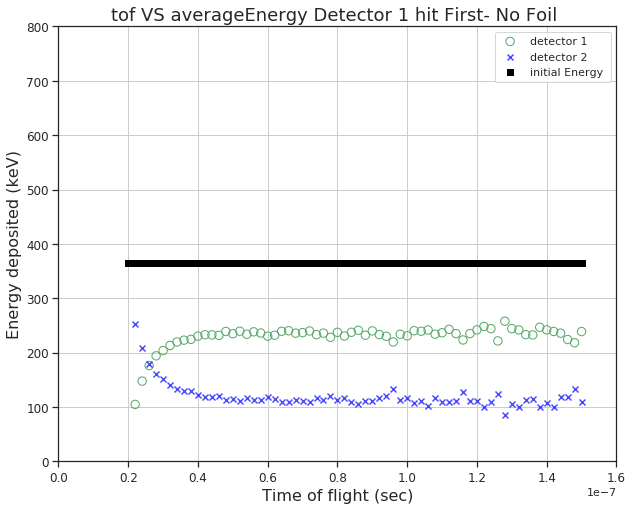

In [18]:
plotDetHitFirstEnergyTOF(t1firstDet1foil0, E1firstDet1foil0, t2firstDet1foil0, E2firstDet1foil0,Foil0_360 ,title = "Detector 1 hit First- No Foil " )

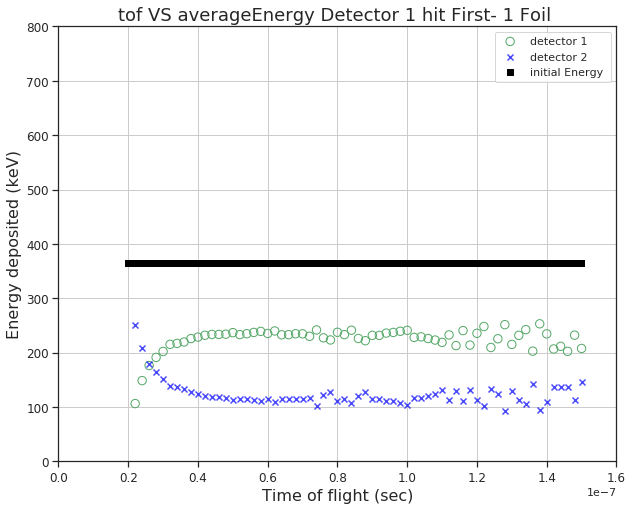

In [19]:
plotDetHitFirstEnergyTOF(t1firstDet1foil1, E1firstDet1foil1, t2firstDet1foil1, E2firstDet1foil1,Foil1_360 ,title = "Detector 1 hit First- 1 Foil " )

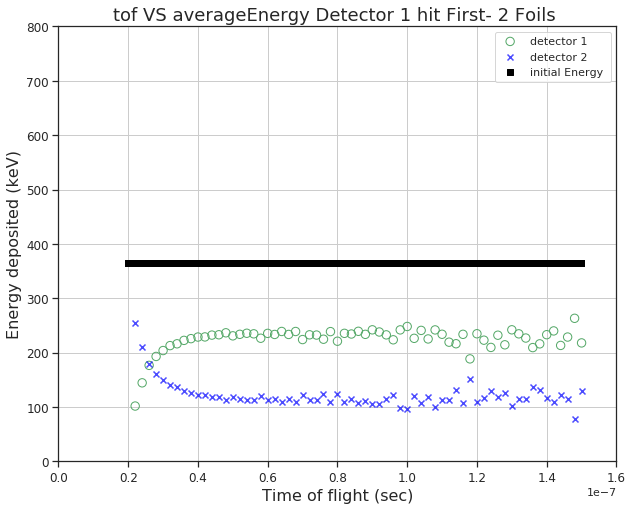

In [20]:
plotDetHitFirstEnergyTOF(t1firstDet1foil1, E1firstDet1foil2, t2firstDet1foil2, E2firstDet1foil2,Foil2_360 ,title = "Detector 1 hit First- 2 Foils " )

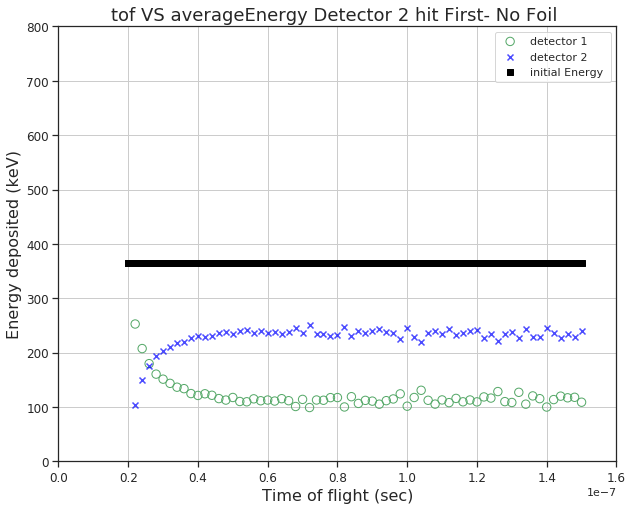

In [20]:
plotDetHitFirstEnergyTOF(t1firstDet2foil0, E1firstDet2foil0, t2firstDet2foil0, E2firstDet2foil0,Foil0_360 ,title = "Detector 2 hit First- No Foil " )

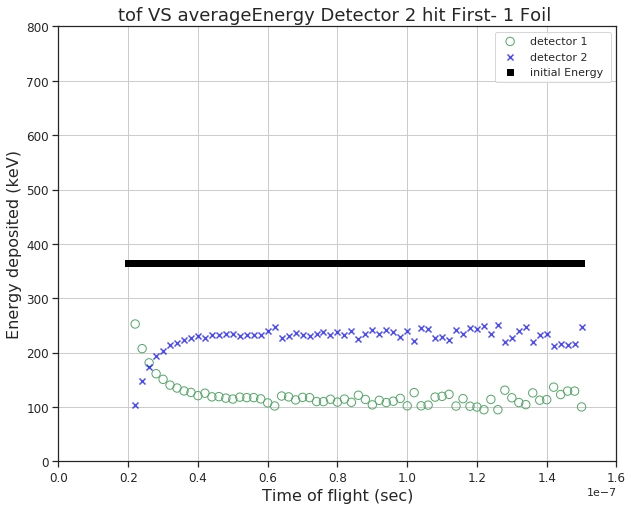

In [21]:
plotDetHitFirstEnergyTOF(t1firstDet2foil1, E1firstDet2foil1, t2firstDet2foil1, E2firstDet2foil1,Foil1_360 ,title = "Detector 2 hit First- 1 Foil " )

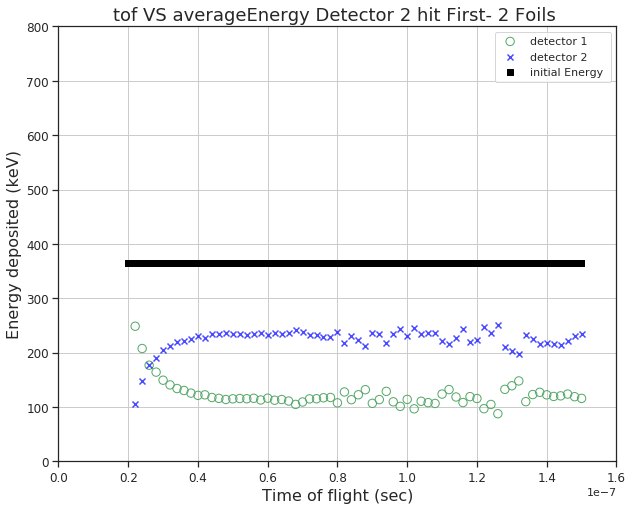

In [21]:
plotDetHitFirstEnergyTOF(t1firstDet2foil2, E1firstDet2foil2, t2firstDet2foil2, E2firstDet2foil2,Foil2_360 ,title = "Detector 2 hit First- 2 Foils " )

Text(0.5, 1.0, 'tof VS averageEnergy all Foil Configs')

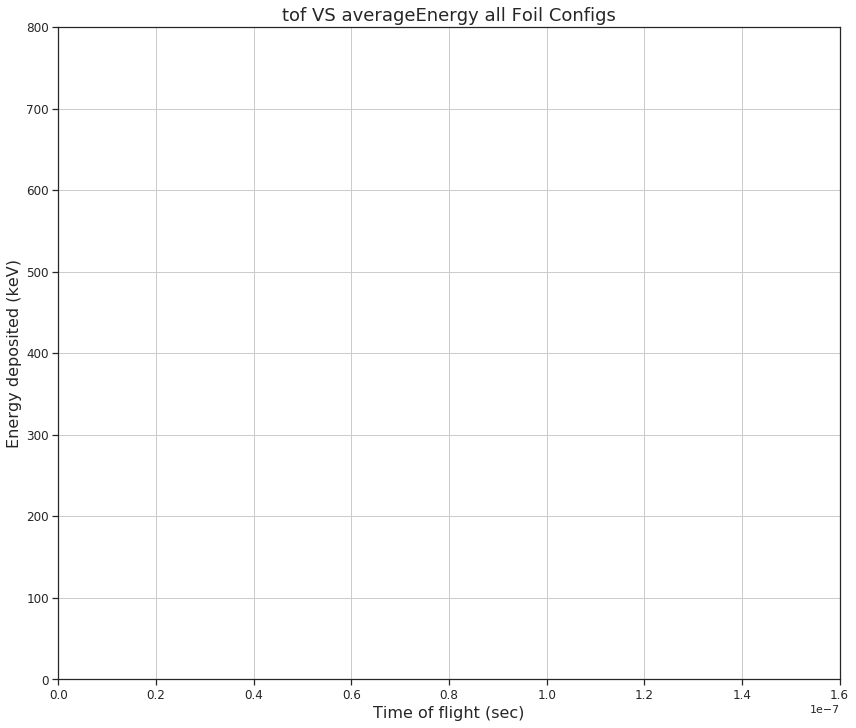

In [36]:
%matplotlib inline
plt.figure(figsize = (14, 12))
#plt.scatter(x = t1firstDet1foil0 ,y = E1firstDet1foil0,  s = 70, facecolors='none', edgecolors='blue', label = '0 Foil detector 1')
#plt.scatter(x = t2firstDet1foil0 ,y = E2firstDet1foil0, marker = 'x', alpha = 0.7 ,label = '0 foil detector 2', color  ='blue')
#plt.scatter(x = t1firstDet1foil1 ,y = E1firstDet1foil1,  s = 70, facecolors='none', edgecolors='red', label = '1 foil detector 1')
#plt.scatter(x = t2firstDet1foil1 ,y = E2firstDet1foil1, marker = 'x', alpha = 0.7 ,label = '1 foil detector 2', color  ='red')
#plt.scatter(x = t1firstDet1foil2 ,y = E1firstDet1foil2,  s = 70, facecolors='none', edgecolors='g', label = '2 foils detector 1')
#plt.scatter(x = t2firstDet1foil2 ,y = E2firstDet1foil2, marker = 'x', alpha = 0.7 ,label = '2 foils detector 2', color  ='green')
plt.plot(x = t1firstDet1foil0 ,y = E1firstDet1foil0, linewidth = '1.0',linestyle = '-',color = 'blue') #s = 70, facecolors='none', edgecolors='blue', label = '0 Foil detector 1')
plt.plot(x = t2firstDet1foil0 ,y = E2firstDet1foil0, linewidth = '1.0',linestyle = '-.',color = 'blue')#marker = 'x', alpha = 0.7 ,label = '0 foil detector 2', color  ='blue')
plt.plot(x = t1firstDet1foil1 ,y = E1firstDet1foil1, linewidth = '1.0',linestyle = '-',color = 'red') #s = 70, facecolors='none', edgecolors='red', label = '1 foil detector 1')
plt.plot(x = t2firstDet1foil1 ,y = E2firstDet1foil1, linewidth = '1.0',linestyle = '-.',color = 'red')#marker = 'x', alpha = 0.7 ,label = '1 foil detector 2', color  ='red')
plt.plot(x = t1firstDet1foil2 ,y = E1firstDet1foil2, linewidth = '1.0',linestyle = '-',color = 'green')# s = 70, facecolors='none', edgecolors='g', label = '2 foils detector 1')
plt.plot(x = t2firstDet1foil2 ,y = E2firstDet1foil2, linewidth = '1.0',linestyle = '-.',color = 'green')#marker = 'x', alpha = 0.7 ,label = '2 foils detector 2', color  ='green')
#plt.scatter(x = Foil0_360['etof'], y = Foil0_360['KE'], color = 'black', marker = 's' , label = 'initial Energy ')
plt.xlim(0, 160e-09)
plt.xticks(fontsize =12)
plt.yticks(fontsize =12)
plt.ylabel('Energy deposited (keV)', fontsize = 16)
plt.xlabel('Time of flight (sec)',fontsize = 16)
#plt.legend()
plt.ylim(0, 800)
plt.grid(which = 'both', axis = 'both')
plt.title('tof VS averageEnergy all Foil Configs', fontsize = 18)

In [31]:
def plot(data, col):
    plt.figure(figsize=(10,6),dpi=500)
    plt.scatter(data[col], y = data.E1, s = 70, facecolors='none', edgecolors='g', label = 'detector 1', alpha = 0.7)
    #plt.scatter(data[col], y = data.E2, s = 70, marker = 'x', alpha = 0.4 ,label = 'detector 2')#facecolors='none', edgecolors='orange',)
    plt.scatter(data[col], y = data.KE , color = 'black', label = data.KE.max())
    plt.xlabel(col, fontsize = 14)
    plt.ylabel('Energy depsited (keV)',fontsize = 16)
    plt.xlim(0, 150e-09)
    plt.xticks(np.arange(0, 150e-09, 20e-09),fontsize=12)
    plt.yticks(np.arange(0., 800., 50.),fontsize=12)
    plt.ticklabel_format(axis = 'X', style = 'scientific')
    plt.ylim(0, 800)
    plt.grid(which = 'both', axis = 'both', linestyle = '-.')
    plt.legend()
    plt.title('Energy deposited vs eTOF for backscattered events', fontsize = 18)
    return (plt.show())

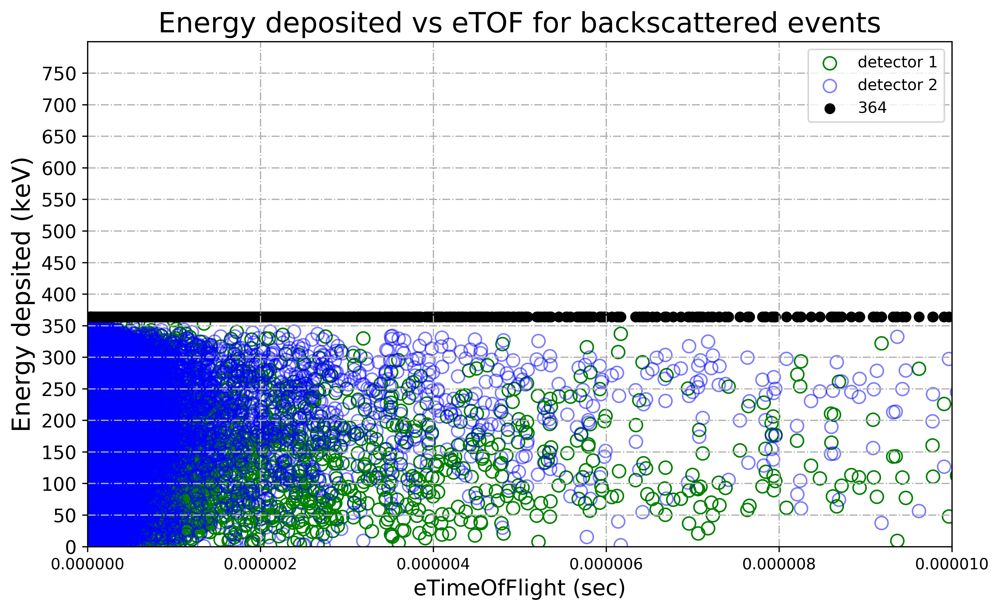

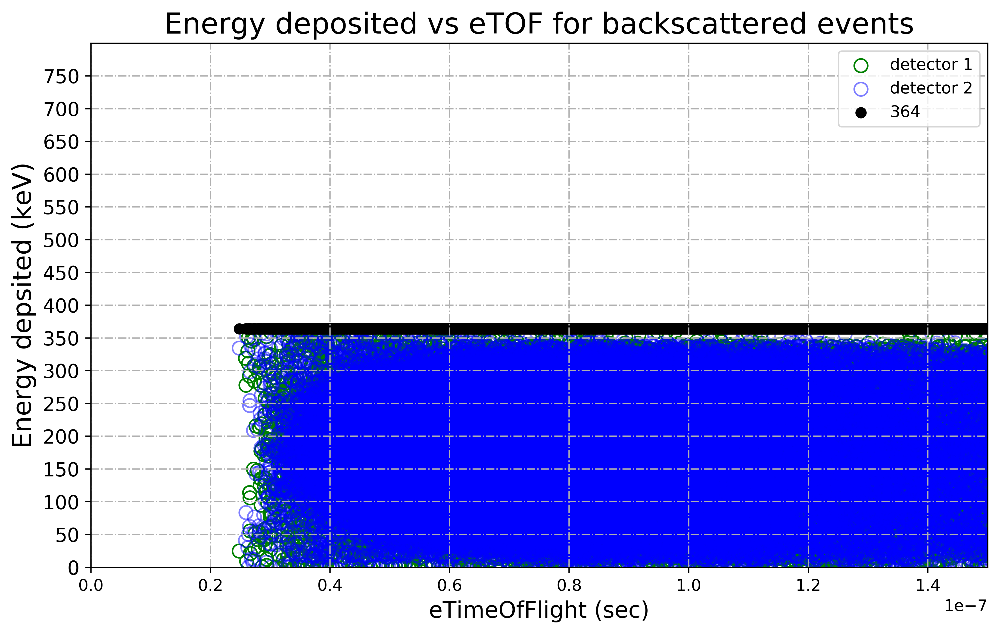

In [23]:
plot(tin1)

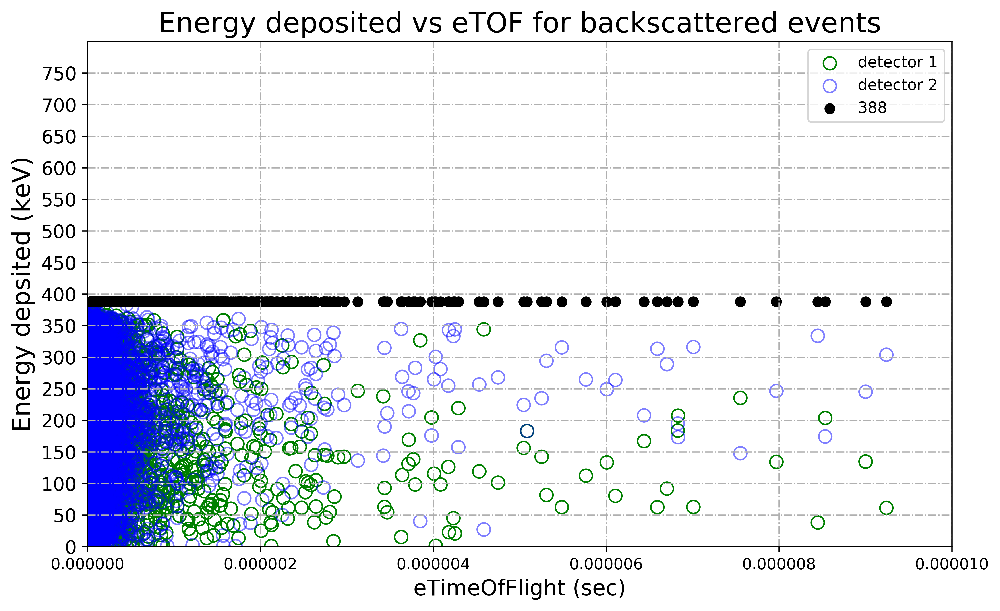

In [21]:
plot(tin2)

In [32]:
less15nsTin1 = less15ns[less15ns['KE'] < 370]

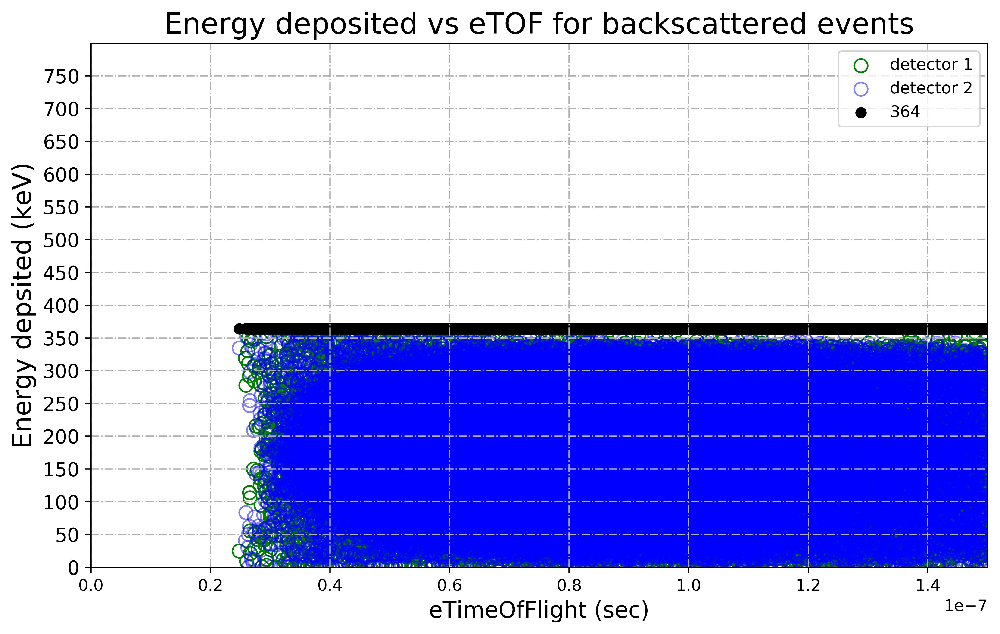

In [33]:
plot(less15nsTin1)

In [35]:
less15nsTin2 = less15ns[less15ns['KE']>370]

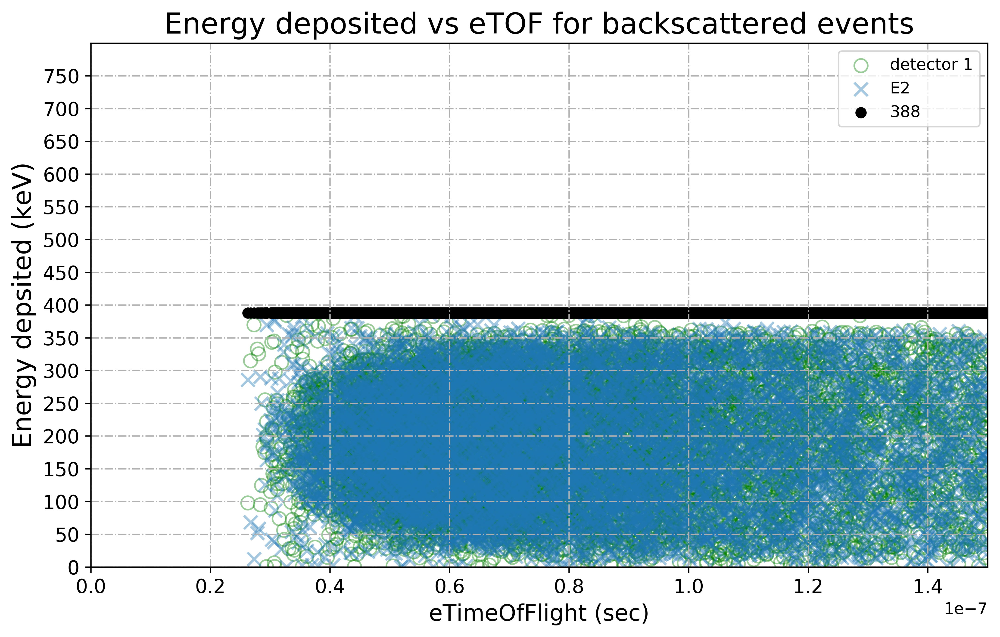

In [47]:
plot(less15nsTin2)

looking for the energy depsited in the second detector (it could possibly  mean detector which gets hit second time after hitting the other detector i.e timeHit_detector A > timeHit_detector B )

In [51]:
hit2first = less15ns[less15ns['t1'] > less15ns['t2']]
hit2firstE1 = hit2first[hit2first['KE'] < 370]

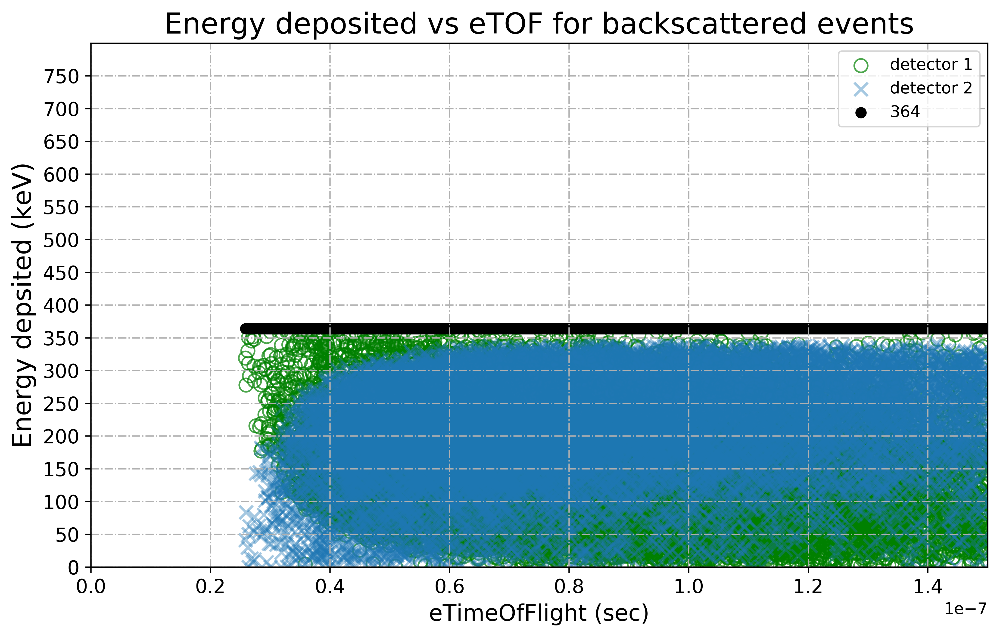

In [55]:
plot(hit2firstE1)

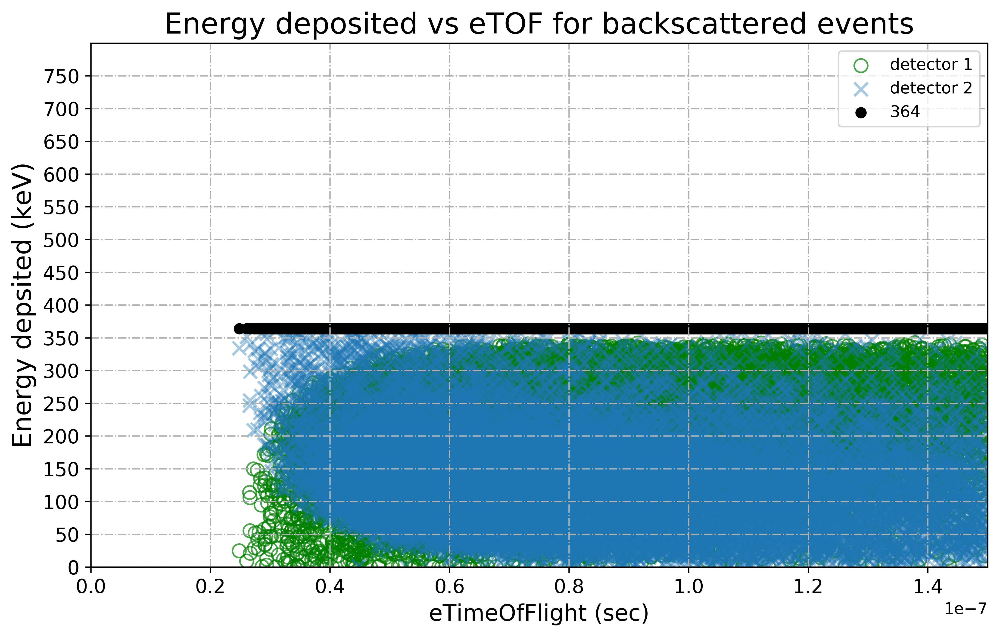

In [57]:
hit1first = less15ns[less15ns['t2'] > less15ns['t1']]
hit1firstE1 = hit1first[hit1first['KE'] < 370]
plot(hit1firstE1)

we see that when e- hits detectoor 1 first it deposits less energy for short time-of-flight
while when time of flight is big enrgy deposited in detector 1 is large 

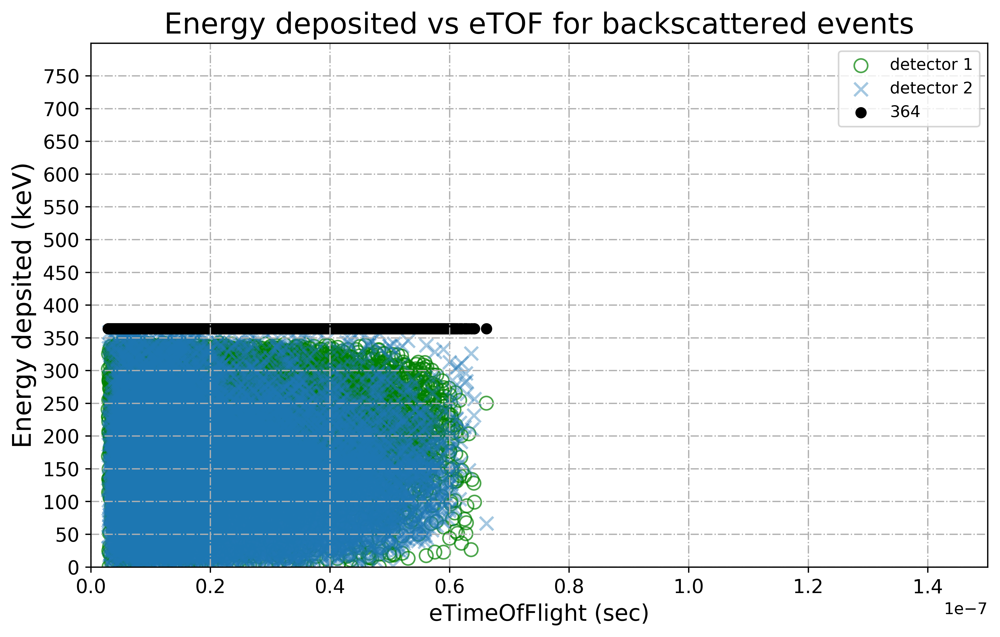

In [64]:
plot(hit1firstE1, col = "t1")

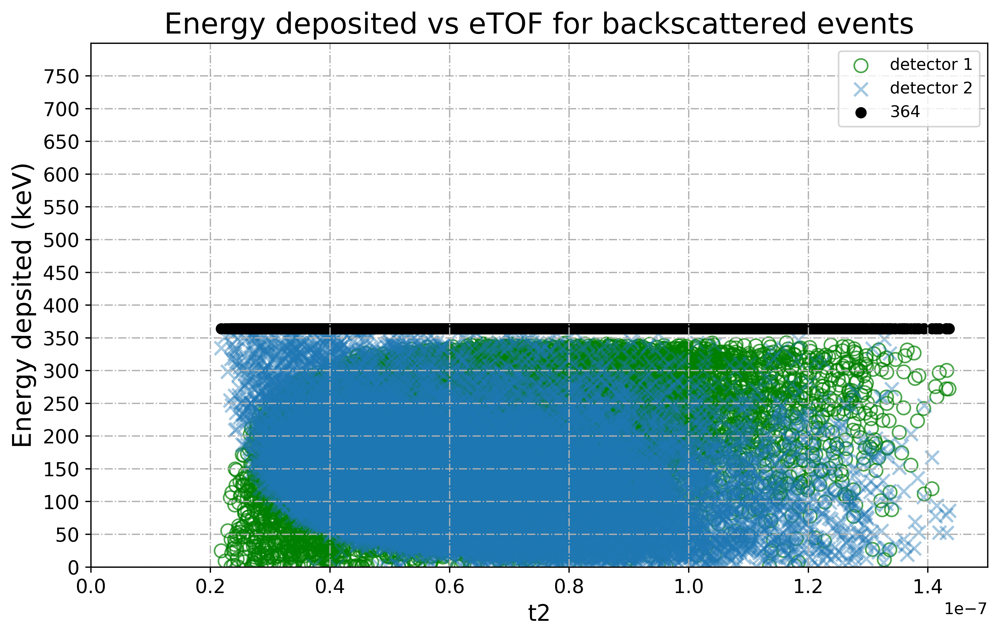

In [67]:
plot(hit1firstE1, col = "t2")

For the above two graphs , for the scene when detector 1 gets hit first 
t1 < 0.6 e-07 
and for E vs t2 we see for smaller t2 energy in detector 1 is small and detector 2 is more ie electron hits detector 1 first deposits small energy in detector 1 and because of more energetic electron  very quickly (small t2) deposits all the rest of the enegy. .

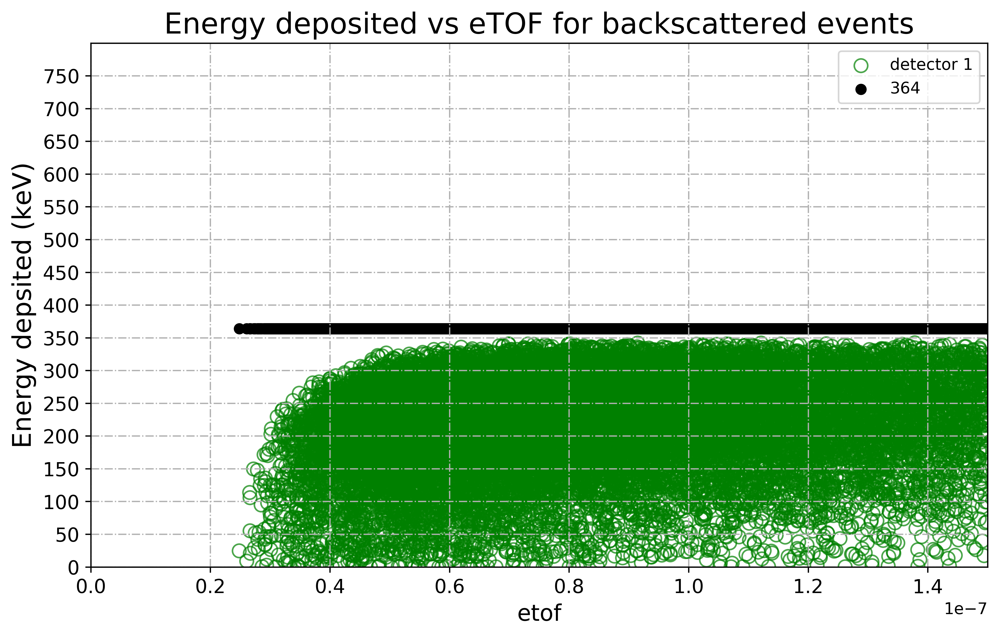

In [71]:
plot(hit1firstE1, col = 'etof')

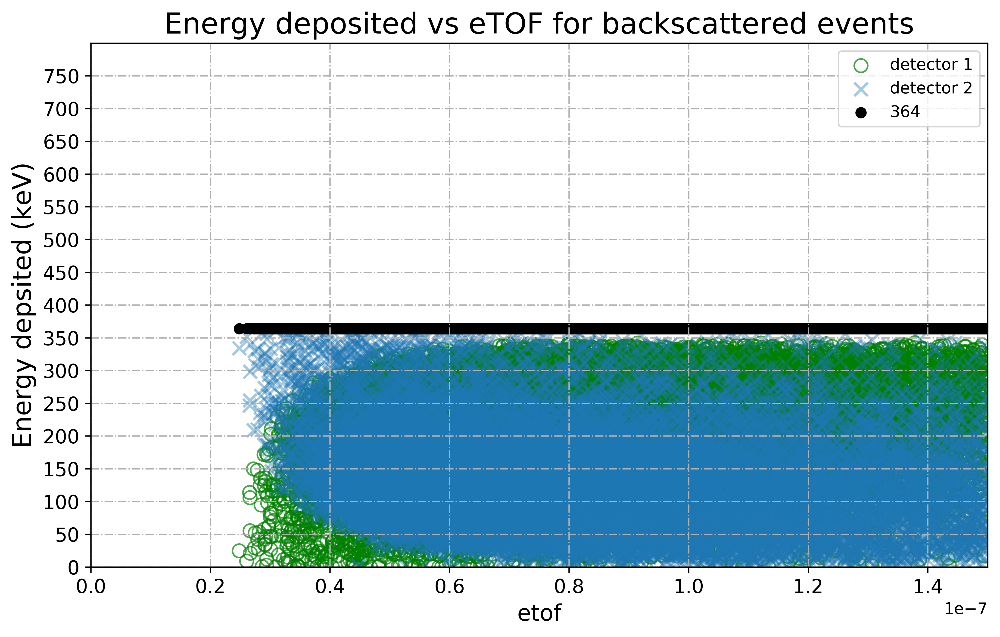

In [68]:
plot(hit1firstE1, col = "etof")

We see the similar trend like E_hit1 vs t2 in the above graph. 
i.e for smaller tof less energy in detector 1 is deposited while when there is more energy deposited in detectr 1 the etof is large. 

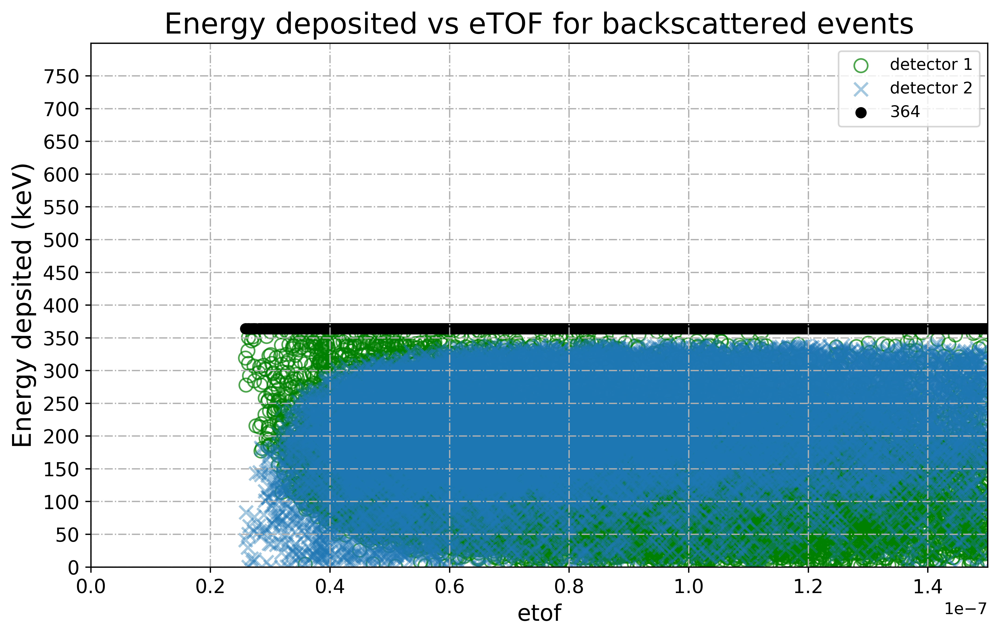

In [69]:
plot(hit2firstE1, col = "etof")

and as expected the trend here is opposite


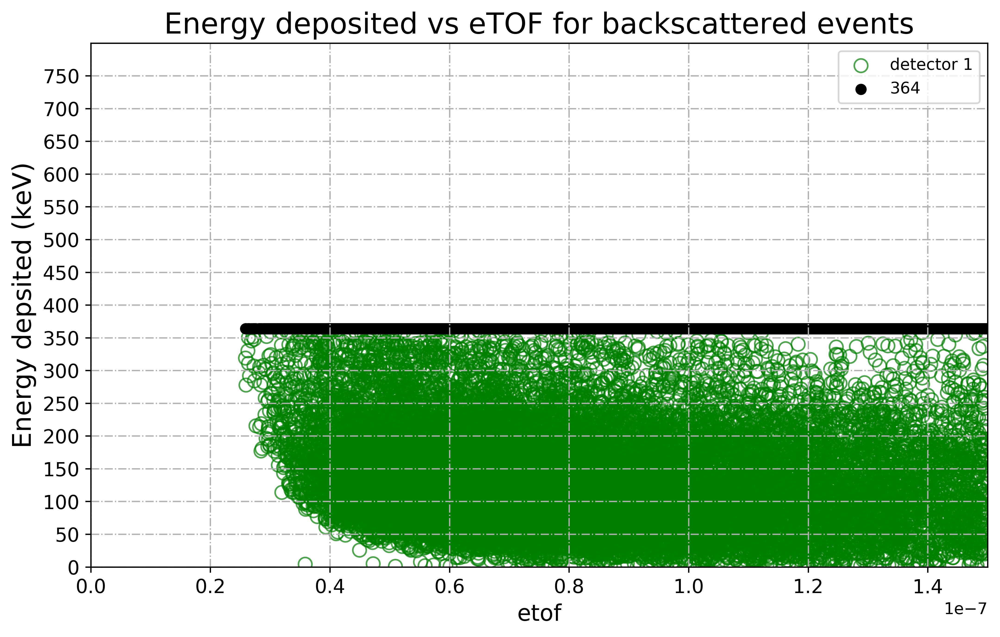

In [72]:
plot(hit2firstE1, col = 'etof')